<a href="https://colab.research.google.com/github/jonshiach/Outreach/blob/main/zombie.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<img src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/MMU_logo.png" width=150 align="right"/>
<img src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/python_logo.png" width="150" align="right"/>


# Modelling a Zombie Outbreak

---
<table align="center">
    <tr>
        <td align="left">
            <span style="font-weight:normal">
                <b>Dr Jon Shiach</b> <br><br>
                Senior Lecturer <br>
                Department of Computing and Mathematics<br>
                Manchester Metropolitan University<br> 
                Email: <a href="mailto:j.shiach@mmu.ac.uk">j.shiach@mmu.ac.uk</a>
            </span>
        </td>
        <td>
            <img width="100" src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/jon_shiach.jpeg">
        </td>
        <td align="left">
            <span style="font-weight:normal">
                <b>Dr Stephen Lynch</b> <br><br> 
                Reader <br> 
                Department of Computing and Mathematics<br>
                Manchester Metropolitan University<br>
                Email: <a href="mailto:s.lynch@mmu.ac.uk">s.lynch@mmu.ac.uk</a>
            </span>
        </td>
        <td>
            <img width="100" src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/stephen_lynch.jpeg">
        </td>
        <td>
            <span style="font-weight:normal">
                <b>Dr Killian O'Brien</b> <br><br>
                Senior Lecturer <br>
                Department of Computing and Mathematics<br>
                Manchester Metropolitan University<br> 
                Email: <a href="mailto:k.m.obrien@mmu.ac.uk">k.m.obrien@mmu.ac.uk</a>
            </span>
        </td>
        <td>
            <img width="100" src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/killian_obrien.jpeg">
        </td>
    </tr>
</table>

---

## Introduction

[**Mathematical modelling**](https://en.wikipedia.org/wiki/Mathematical_model) is a description of a situation or scenario that is described using mathematical concepts. These models can be very useful as they can allow us to identify possible solutions without first implementing them in the real world. For example, NASA used mathematical models to predict the forces experienced by astronauts to see whether they could survive a trip into space. Here we are going to look at a type of mathematical model called an [**Agent Based Model (ABM)**](https://en.wikipedia.org/wiki/Agent-based_model) which can be used to model the behaviour of a group of animals or people. Agent based models consist of a number of autonomous agents which are given a set of rules that govern the agents behaviour in the system. For example, an agent may represent a predator which is given a rule that it will chase the nearest prey. This Jupyter notebook will introduce you to agent based models and how can we write [**Python**](https://www.python.org/) programs to model complex behaviour. The programs are written for you but you can make changes to the parameters or even add to the programs if you wish.

### Jupyter notebooks

Jupyter notebooks are documents that combine text and Python code which allow readable documents such as this one to be created that contain executable code used to perform calculations. To run code in a notebook simply click on the code and then on the run button, or alternatively, press the **ctrl + enter** keys at the same time. Since we will be using commands to perform calculations and produce our models we need to import some commands to help us to do this. Run the code below to import the commands.

In [1]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import animation, patches, collections
from IPython.display import HTML
from ipywidgets import IntProgress
matplotlib.rcParams['animation.embed_limit'] = 2**128

Now we can perform some calculations. The Python code below calculates the length of the hypotenuse of a right angled triangle using the lengths of the two smallest sides and prints the result. Note how the equation $c = \sqrt{a^2 + b^2}$ is entered in a similar way to how we write it on a piece of paper. Can you calculate the length of the hypotenuse when $a = 5$ and $b = 12$

In [2]:
a = 3
b = 4
c = np.sqrt(a ** 2 + b ** 2)
print(c)

5.0


---
## Agent based modelling

<img src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/field.svg" align=right width=350>

An Agent Based Model (ABM) uses individual autonomous **agents** to which we can give **rules** that will govern their movement and behaviour. In the models we will use here the agents exist within a finite rectangular region of a given width and height. Each agent is described by its **position** within the region and **velocity**. The position is given by a set of co-ordinates $(x,y)$ where $x$ and $y$ are the horizontal and vertical distances from the bottom left-hand corner of the region. The velocity, which governs the direction the agent moves in, is given by the **velocity vector** (a vector is an arrow with a direction and length) which is represented by $(v_x,v_y)$ where $v_x$ and $v_y$ are the horizontal and vertical speeds of the agent. We can calculate the speed of an agent from the velocity vector using Pythagoras' theorem

$$\textsf{speed} = \sqrt{ v_x ^2 + v_y ^ 2}.$$

This is known as the **norm** of the velocity vector and is equivalent to the length of the vector. The Python code below defines a function called `norm()` which calculates the norm of the vector `(vx, vy)`. 

In [3]:
def norm(vx, vy):
    return np.sqrt(vx ** 2 + vy ** 2)

To program an agent based model in Python we start by defining an agent object which contains all of the commands that are applied to an agent. The code below defines an agent and gives it a random position and velocity as well as some other attributes which are explained by the comments following the `#` symbol.

In [4]:
class boid:
    def __init__(self):
        self.maxspeed = 10                                   # maximum speed of the agent
        self.minspeed = 5                                    # minimum speed of the agent
        self.x = np.random.uniform(0, width)                 # horizontal co-ordinate
        self.y = np.random.uniform(0, height)                # vertical co-ordinate
        self.vx = self.maxspeed * np.random.uniform(-1, 1)   # horizontal velocity
        self.vy = self.maxspeed * np.random.uniform(-1, 1)   # vertical velocity
        self.neighbours = []                                 # list of neighbouring agents
        self.status = "boid"                                 # status of the agent
        self.colour = "blue"                                 # colour of the agent (for plotting)
        self.move = True                                     # does the agent move? 
        
    def get_agent_list():
        np.random.seed(0)
        agent_list = [boid() for _ in range(nagents)]
        agent_types = ["boid"]
        agent_colours = ["blue"]

        return agent_list, agent_types, agent_colours

### Movement

To model the movement of agents we divide the time which we are simulating into lots of individual **time steps**. If we know the position and velocity of an agent at one time step we can calculate the position at the next time step using

$$\textsf{new position} = \textsf{current position} + \textsf{velocity vector} \times \textsf{time step}.$$

This is shown in the diagram below where $\mathbf{p}_1$ is the current position of the agent and $\mathbf{p}_2$ and $\mathbf{p}_3$ are the positions in the next two time steps.

<img src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/movement.svg" align=center width=300>

In the diagram above we see that the velocity vector does not change so this agent will continue to move along that same path forever. The velocity vector will change if there is some external force applied to the agent, for example, an agent may be attracted towards a particular target. The change in the velocity is known as **acceleration** which will be determined by any rules that we impose on our agents. 

In [5]:
class boid(boid):
    def move_agent(self):
        if self.move:
            self.x += self.vx * dt
            self.y += self.vy * dt

### Steering

The **steering rules** that affect the movement of an agent will each generate a steering vector that are added together to give an **acceleration vector**

$$\textsf{acceleration vector} = \textsf{steering vector 1} + \textsf{steering vector 2} + \textsf{steering vector 3}$$

<img src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/steering1.svg" align="center" />

An example of a rule imposed on an agent may be that it will travel towards a particular target as shown in the diagram below. The steering vector pointing in the direction of the target is calculated using 

$$\textsf{steering vector} = \textsf{target} - \textsf{position}.$$

<img src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/steering2.svg" align="center" />

Since we may be combining several steering rules we may wish to prioritise some over the others. We can do this by limiting the steering vector by a **steering factor** which is a number that we choose the value of in order to replicate the behaviour we want.

$$\textsf{acceleration vector} = \textsf{steering vector} \times \textsf{steering factor}.$$

<img src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/steering3.svg" align="center" />

The diagram below shows how an agent will move towards a target over several time steps. Note that since the acceleration vector is limited by the steering factor the agents does immediately turn in the direction of the target, rather it gradually turns over a number of time steps. 

<img src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/steering4.svg" width=350>

### Keeping the agents within the region

We must ensure that an agent does not pass through the edges of the region and escape. This is shown in the diagram below where the agent is approaching the bottom edge and if no external for is applied it would pass through the edge and out of the region.

<img src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/edges.svg" align=center width=400>

To ensure agents remain in the region we apply a steering force if an agent gets too close to an edge which forces it to move away from the edge. A buffer zone is defined that contains the region within some distance of the edge, if an agent is in the buffer zone then a steering force is applied calculated using

\begin{align*}
    \textsf{steering vector} &= \frac{\textsf{direction vector}}{\textsf{distance from edge}},
\end{align*}

where the direction vector is a vector that points towards the interior of the region. By dividing the direction vector by the distance from the edge the steering force is week when the agent is further away from the edge but becomes progressively stronger as the distance from the decreases. This means that the agent will gradually turn away from the edge.

The code below defines the function `avoid_edges()` which applies this rule for all four edges of the region defined the by width and height of the region that contains our agents and the size of the buffer zone which is defined as 2 here.

In [6]:
class boid(boid):
    def avoid_edges(self):
        x_steer, y_steer, buffer = 0, 0, 2
        if self.x <= buffer:
            x_steer += buffer / self.x
        if self.x >= width - buffer:
            x_steer -= buffer / (width - self.x)
        if self.y <= buffer:
            y_steer += buffer / self.y
        if self.y >= height - buffer:
            y_steer -= buffer / (height - self.y)
            
        return x_steer, y_steer

--- 
## Modelling flocking behaviour

The first model we are going to look at is the modelling of flocking behaviour that can be seen in shoals of fish. Each individual fish in the group reacts to the other fish that surround it and adjusts its movement accordingly. The model [**Boids**](https://en.wikipedia.org/wiki/Boids) which was developed by Craig Reynolds uses three simple rules that are applied to the agents in the model to simulate flocking behaviour, these rules are:

- **Alignment**: an agent will steer in the direction of the average velocity vector for the other agents in the neighbourhood.
- **Cohesion**: an agent will steer towards the average position of the other agents in the neighbourhood.
- **Separation**: an agent will steer away from any agent that is too close to the agent.

The acceleration forces for all three of these rules is calculated and added to the acceleration vector for an agent.

### Neighbouring agents

<img src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/neighbourhood.svg" align=right width=300>

We want our agents to react to other agents which are the vicinity, for example, if we have an agent that represents a predator it will want to chase after any prey agent and a prey agent will want to flee away from a predator. In order to do this we need to determine which of the other agents can be detected by our agent. The simplest way to do this is to define a **detection zone** that is a circle surround our agent and all other agents that are within this circle are considered to have been detected by our agent. This could represent a predator using their senses of vision and smell to hunt for their prey. Agents that are within the detection zone are known as **neighbouring agents** because that are the agents that are nearest to our agent.

The code below defines the function `Neighbours()` which loops through all of the other agents in the model and calculates the squared distance to a current agent. If this distance is less than the square of the detection radius then it is added to a list of neighbours. The reason why the square of the distance is used is to avoid having to calculate a square root which is slower for a computer to calculate. 

In [7]:
class boid(boid):
    def find_neighbours(self, agent_list):
        self.neighbours = []
        for neighbour in agent_list: 
            if id(self) == id(neighbour):
                continue
            
            if norm(self.x - neighbour.x, self.y - neighbour.y) < detection_radius:
                self.neighbours.append(neighbour)

### Alignment

<img src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/alignment.svg" align=right width=250>

The alignment rule states that an agent will align itself to the average velocity vector of its neighbouring agents. The average velocity is calculated using

$$\textsf{average velocity} = \frac{\displaystyle\sum \textsf{velocity of neighbour}}{\textsf{number of neighbours}}.$$

The symbol $\sum$ is the Greek character *sigma* which is equivalent to the Latin character *s* and is used to denote the sum of a group of numbers. The equation above says that we add up all of the velocity vectors of the neighbouring agents and divide by the number of neighbours to get the average velocity. The steering vector for aligning to the neighbouring agents is then calculated by subtracting the agent velocity from the average velocity of the neighbourng agents

\begin{align*}
    \textsf{alignment vector} &= \textsf{average velocity} - \textsf{agent velocity}.
\end{align*}
 
The alignment vector is then limited to ensure that its norm is not greater than the alignment factor which controls the extent to which the agent aligns to its neighbours. The code below defines the function `alignment()` applies the alignment rule to the current agent.

In [8]:
class boid(boid): 
    def alignment(self):
        n, sum_vx, sum_vy, x_alignment, y_alignment = 0, 0, 0, 0, 0
        for neighbour in self.neighbours:
            sum_vx += neighbour.vx
            sum_vy += neighbour.vy
            n += 1
            
        if n > 0:
            x_alignment = sum_vx / n - self.vx
            y_alignment = sum_vy / n - self.vy
            
        return limit(x_alignment, y_alignment, 0, alignment_factor)

The function `limit()` used in the `alignment()` function is defined below. It uses the `norm()` function to limit a vector `v` to ensure that its norm is within `min_norm` and `max_norm`.

In [9]:
def limit(vx, vy, min_norm, max_norm):
    v_norm, scale = norm(vx, vy), 1
    if v_norm > 0 and v_norm < min_norm:
        scale = min_norm / (v_norm)
    elif v_norm > max_norm:
        scale = max_norm / v_norm
        
    return vx * scale, vy * scale

### Cohesion

<img src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/cohesion.svg" align=right width=300>

The cohesion rule states that an agent will steer towards the average position of it's neighbouring agents. The steering vector is calculated by subtracting the agent position from the average position of the neigbouring agents

\begin{align*}
    \textsf{cohesion vector} &= \frac{\displaystyle\sum \textsf{position of neighbour}}{\textsf{number of neighbours}} - \textsf{agent position}.
\end{align*}

Like with the alignment vector, the cohesion vector is then limited so that it's norm does not exceed the cohesion factor. The code below defines the function `Cohesion()` applied the cohesion rule to the current agent.

In [10]:
class boid(boid):
    def cohesion(self):
        n, sum_x, sum_y, x_cohesion, y_cohesion = 0, 0, 0, 0, 0
        for neighbour in self.neighbours:
            sum_x += neighbour.x
            sum_y += neighbour.y
            n += 1
            
        if n > 0:
            x_cohesion = sum_x / n - self.x
            y_cohesion = sum_y / n - self.y
        
        return limit(x_cohesion, y_cohesion, 0, cohesion_factor)

### Separation

<img src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/separation.svg" align=right width=250>

The separation rule states that an agent will steer away from agents that are within some small distance of it. For those neighbouring agents that are too close we calculate the steering vector using

\begin{align*}
    \textsf{separation vector} &= \sum \dfrac{\textsf{position of agent} - \textsf{position of neighbour}}{\textsf{distance to neighbour}}.
\end{align*}

By dividing the vector that points away from the neighbouring agent by the distance to that neighbour we scale the separation vector so that the closer a neighbour is, the stronger the seperation force from that neighbour. Once again the separation vector is limited so that it does not exceed the separation factor. 

The code below defines a function called `separation()` applies the separation rule for the current agent.

In [11]:
class boid(boid):     
    def separation(self):
        x_separation, y_separation = 0, 0
        for neighbour in self.neighbours:
            d = norm(self.x - neighbour.x, self.y - neighbour.y)
            if d < separation_radius:
                x_separation += (self.x - neighbour.x) / d
                y_separation += (self.y - neighbour.y) / d
                
        return limit(x_separation, y_separation, 0, separation_factor)

### Applying the agent rules

The code below defines the function `agent_rules()` which applies the rules that govern the behaviour of the agent. The individual steering vectors for avoiding the edges of the region, alignment, cohesion and separation are calculated and added to the current velocity vector for the agent. The velocity vector is then limited to ensure that it's norm is between the minimum and maximum speed of the agent.

In [12]:
class boid(boid):
    def agent_rules(self):
        x_edge, y_edge = self.avoid_edges()
        x_align, y_align = self.alignment()
        x_cohesion, y_cohesion = self.cohesion()
        x_separate, y_separate = self.separation()
        
        self.vx += x_edge + x_align + x_cohesion + x_separate
        self.vy += y_edge + y_align + y_cohesion + y_separate
        self.vx, self.vy = limit(self.vx, self.vy, self.minspeed, self.maxspeed)

### Stepping through time

Now that we have defined the rules for our model we now need to apply these rules for each time step. For each time step we first calculate the rules for each agent in the model and then calculate the new positions of each agent using the acceleration vector that has been calculated when we applied the rules. 

The function `abm()` defined initialises the positions and velocities of the agents in the model and applies the model through time. 

In [13]:
def abm(model): 
    
    def update(n):
        
        # Calculate the rules for each agent
        for agent in agent_list:
            agent.find_neighbours(agent_list)
            agent.agent_rules()
            
        # Plot agents
        patches = []
        colours = []
        for agent in agent_list:
            
            # Move agent
            agent.move_agent()

            # Plot agent as an isocelese triangle
            angle = np.arctan2(agent.vy, agent.vx)
            cos, sin, s = np.cos(angle), np.sin(angle), min(width, height) / 100
            vertices = np.array([[-1, -1, 1], [2, 0, 1], [-1, 1, 1]])
            A = np.array([[s * cos, s* sin, 0], [-s * sin, s * cos, 0], [agent.x, agent.y, 1]])
            vertices = np.dot(vertices, A)
            triangle = plt.Polygon(vertices[:,:2])
            patches.append(triangle)
            colours.append(agent.colour)
            
        collection.set_paths(patches)
        collection.set_color(colours)
        progress_bar.value += 1

        return collection,

    # Generate agent lists
    agent_list, agent_types, agent_colours = model.get_agent_list()
    
    # Setup plot
    fig, ax = plt.subplots(figsize=(8, 8 * height / width))
    plt.axis([0, width, 0, height])
    collection = collections.PatchCollection([plt.Polygon(np.zeros((3,2))) for _ in range(nagents)])
    ax.add_collection(collection)
    progress_bar = IntProgress(min=0, max=int(fps * tmax), description="Running...")
    display(progress_bar)

    # Create animation 
    anim = animation.FuncAnimation(fig, update, frames=int(tmax * fps), blit=True)
    plt.close()
    
    return anim

### Running the model

The following code defines the various parameters that define the model before running the model and generating the animation. Try experimenting with the model by changing these parameters and then clicking on the 'Run' button. 

In [14]:
# Model parameters
nagents = 50               # number of agents
width, height = 40, 30     # width and height of the area
tmax = 20                  # max time for the simulation
fps = 30                   # frames per second for the animation
dt = 1 / fps               # seconds elapsed during 1 frame of the animation
detection_radius = 5       # radius for detecting neighbouring agents
separation_radius = 1      # radius for separating agents

# Steering factors (how much does each behaviour affect the movement of the agent)
alignment_factor = 0.2
cohesion_factor = 0.2
separation_factor = 0.4
    
# Run simulation
anim = abm(boid)
HTML(anim.to_jshtml(fps=fps))

IntProgress(value=0, description='Running...', max=600)

---
## Modelling a zombie outbreak

<img src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/zombie.png" align=right width=150>

We have seen with the Boids model that we can use agent based modelling to model a population of animals that exhibit flocking behaviour. We can adapt this model to model the behaviour of human populations. Here we are going to model the (unlikely) event of a zombie outbreak. Zombies have become a popular monster in movies, TV series and computer games such as *Night of the Living Dead*, *The Walking Dead* and *The Last of Us*.

Interpretations of the zombie monster differs so here we will consider a zombie as an reanimated corpse that attempts to feed on humans. If a human is caught and bitten by a zombie they will die and the zombie will feed on the corpse. After a certain amount of time the zombie will cease feeding on the corpse and start looking for another victim and the corpse will eventually reanimate and become a zombie.

To adapt the Boids model we will assign a status to our agents. Initially this is `human` for most of the agents with a small number of agents being given the status `zombie`. As the model steps through time the status of a human agent could change to `corpse` if it has been caught by a zombie and the status of a zombie agent could change to `eating` as it feeds on a corpse.

The code below defines defines functions that change the status of the agents. Zombies that are eating and corpses are prevented from moving by setting `self.move = False` and they also given a timer to record the time until they change to the `zombie` status.

In [15]:
class zombie(boid):
    def __init__(self):
        super().__init__()
        self.status = "human"
        self.minspeed = 0
        self.maxspeed = human_speed
        self.colour = "blue"
        
    def change_to_zombie(self):
        self.status = "zombie"
        self.maxspeed = zombie_speed
        self.colour = "limegreen"
        self.move = True
        
    def change_to_corpse(self):
        self.status = "corpse"
        self.colour = "red"
        self.timer = reanimation_time
        self.move = False
        
    def change_to_eating(self):
        self.status = "eating"
        self.timer = feeding_time
        self.move = False
        
    def get_agent_list():
        np.random.seed(0)
        agent_list = [zombie() for _ in range(nagents)]
        for agent in agent_list[:nzombies]:
            agent.change_to_zombie()
            
        agent_types = ["human", "zombie", "eating", "corpse"]
        agent_colours = ["blue", "limegreen", "black", "red"]

        return agent_list, agent_types, agent_colours

### Random path

<img src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/randomwalk.svg" width=300 align="right">

In the absence of any rules that affect the steering forwards for the agents the agent will just move in a straight line. We don't necessary want this for the zombie model where zombies will wander around so we can make them move along a random path. At each time step, a target is placed at a random position in front of the agent which will cause it to steer towards the target. This is done by calculating the angle that the agent is moving towards relative to a horizontal line and then adding a random angle between $-\pi$ and $\pi$ ($\pi$ is equivalent to 180$^\circ$). Using sine and cosine functions we can then calculate the target position.

The function called `RandomPath()` defined below alters the agents acceleration vector so that it will move along a random path.

In [16]:
class zombie(zombie):
    def random_path(self):
        agent_angle = np.arctan2(self.vy, self.vx)
        target_angle = agent_angle + np.pi * np.random.uniform(-1, 1)
        
        return np.cos(target_angle), np.sin(target_angle)

### Humans evading zombies

<img src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/evade_zombies.png" width=250 align="right">

Of course a human agent will want to avoid being eaten by a zombie so we will give the humans a rule that if they detect a zombie, or multiple zombies, they will try to run away in the opposite direction. The code below defines a function called `evade()` which checks if the agent status is `human` and if so calculates the acceleration force for evading any neighbouring zombie agents. This is similar to the [`separation()`](#Separation) function used in the Boids model.

In [17]:
class zombie(zombie):
    def evade(self):
        x_steer, y_steer = 0, 0
        for neighbour in self.neighbours:
            if neighbour.status == "zombie" or neighbour.status == "eating":
                d = norm(self.x - neighbour.x, self.y - neighbour.y)
                x_steer += (self.x - neighbour.x) / d
                y_steer += (self.y - neighbour.y) / d
                
        return x_steer, y_steer

### Zombie chasing humans

<img src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/running zombie.png" width=150 align="left">

The zombie agents will look for any nearby human agents and chase the nearest one. The code for doing this is shown in the function `chase()` below. It searches for the nearest human agent and calculates the steering vector that steers the zombie towards the human. If the distance between the zombie and human agents is less than 1 the human has considered to be caught by the zombie so the zombie agent is changed to an eating zombie and the human agent is changed to a corpse.

In [18]:
class zombie(zombie):   
    def chase(self):
        x_steer, y_steer, dmin = 0, 0, detection_radius
        for neighbour in self.neighbours:
            if neighbour.status == "human":
                d = norm(self.x - neighbour.x, self.y - neighbour.y)
                if d < 1:
                    self.change_to_eating()
                    neighbour.change_to_corpse()
                    return 0, 0
                elif d < dmin:
                    x_steer = neighbour.x - self.x
                    y_steer = neighbour.y - self.y
                    dmin = d
        
        return x_steer, y_steer

### Applying the agent rules

The `agent_rules()` function defined below combines the `avoid_edges()`, `random_path()`, `evade()` and `chase()` rules for our Zombie model. 

In [19]:
class zombie(zombie):
    def agent_rules(self):
        x_edge, y_edge = self.avoid_edges()
        x_random, y_random = self.random_path()
        
        if self.status == "human":
            x_evade, y_evade = self.evade()
            self.vx += x_edge + x_random + x_evade
            self.vy += y_edge + y_random + y_evade

        elif self.status == "zombie":
            x_chase, y_chase = self.chase()
            self.vx += x_edge + x_random + x_chase
            self.vy += y_edge + y_random + y_chase
            
        else:
            self.timer -= dt
            if self.timer < 0:
                self.change_to_zombie()

        self.vx, self.vy = limit(self.vx, self.vy, 0, self.maxspeed)

### Running the model

The code below defines the model parameters and runs the model. Here the human agents have been given a maximum speed of 5 whereas the zombie agents have a maximum speed of 3 since common representations of zombies show them as slow lumbering creatures. The zombie creatures in the film *28 Days Later* and the computer game *The Last of Us* move as fast as humans which can easily be modelled by changing the speed parameters. Try experimenting with different parameters to see what affects this has on the model. 

In [20]:
# Model parameters
nagents = 50               # number of agents
nzombies = 5               # initial number of zombies
tmax = 10                  # max time for the simulation
detection_radius = 10      # radius for detecting neighbouring agents
separation_radius = 1      # radius for avoiding neighbouring agents
human_speed = 8            # maximum speed of a human
zombie_speed = 5           # maximum speed of a zombie
feeding_time = 2           # time taken for a zombie to feed on a corpse
reanimation_time = 4       # time taken for a corpse to reanimate as a zombie

# Run simulation
anim = abm(zombie)
HTML(anim.to_jshtml(fps=fps))

IntProgress(value=0, description='Running...', max=300)

### Plotting the populations

The animations produced using the `abm()` function show us which agents are humans and which are zombies at a given time but it isn't easy to see how the number (or population) of each agent types change over time. The function `abm_populations()` defined below calculates the model and counts the number of each agent type at each time step and stores it in an array called `population`. After the model has been run it then plots the populations over time. 

Note that this function does not generate an animation since that takes too long to compute.

IntProgress(value=0, description='Running...', max=1200)

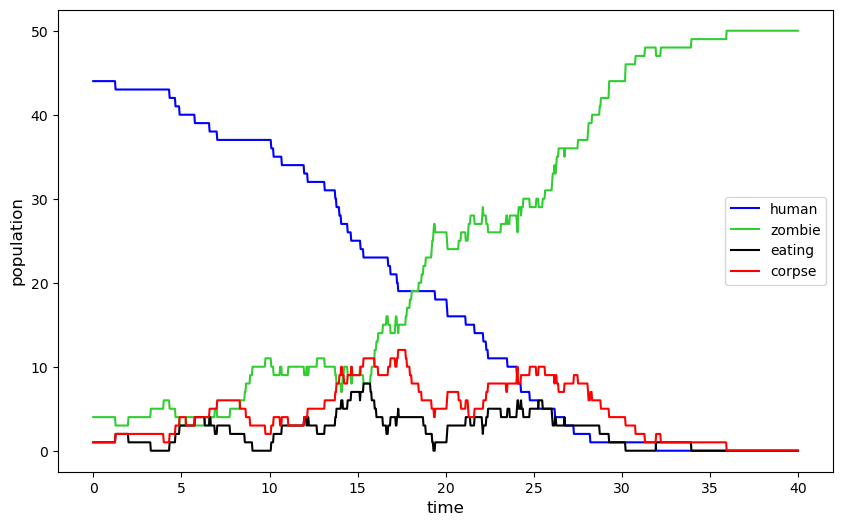

In [21]:
def abm_populations(model):
    
    # Generate agent list
    agent_list, agent_types, agent_colours = model.get_agent_list()
    
    # Initialise population array
    nframes = int(tmax * fps)
    population = np.zeros((nframes, len(agent_types)))
    
    # Create progree bar
    progress_bar = IntProgress(min=0, max=int(fps * tmax), description="Running...")
    display(progress_bar)
    
    
    # Loop through frames
    for i in range(nframes):
        
        # Calculate the rules for each agent
        for agent in agent_list:
            agent.find_neighbours(agent_list)
            agent.agent_rules()
                
        # Move agents
        for agent in agent_list:
            agent.move_agent()
            
            # update the population counts
            population[i,agent_types.index(agent.status)] += 1
        
        # Update progress bar
        progress_bar.value += 1
                

    # Plot populations
    t = np.arange(nframes) * dt
    fig, ax = plt.subplots(figsize=(10,6))
    for i in range(len(agent_types)):
        plt.plot(t, population[:,i], label=agent_types[i], c=agent_colours[i])
    plt.xlabel("time", fontsize=12)
    plt.ylabel("population", fontsize=12)
    plt.legend()
    plt.show()
   

# Simulation parameters
tmax = 40

# Run model and plot populations    
abm_populations(zombie)   

--- 
## Modelling the spread of Covid

<img src="https://raw.githubusercontent.com/jonshiach/Outreach/main/Images/covid.png" align=right width=200>

Perhaps a more realistic scenario in which to apply our agent based model is the modelling the spread of the Covid virus. This model is similar to the Zombie model in some respects but without the chase and evade behaviours (we will assume that those people infected with Covid will not want to purposely infect other people). 

The Covid virus is like many other viruses such as the common cold where the virus lives within a host. A person infected with the virus may suffer from symptoms such as breathing difficulties and fever which can in rare occasions unfortunately result in the death of the host. After a time the hosts immune system will fight off the virus and the host will recover and become immune from being reinfected by the same virus. During the time when the host is infected with the virus they can infect other people who are close by. 

To help prevent the spread of the Covid virus we can implement the following strategies which we can include in our model:

- **Social distancing**: agents will attempt to remain more than a certain distance from other agents.
- **Quarantining**: after a certain time infected agents will quarantine and will not be able to infect other agents.

Social distancing can be modelled using the [`separation()`](#separation) function from the [Boids](#Separation) model and quarantining can be modelled by moving an agent out of the region and away from the other agents.

We will start with assigning the majority of our agents with the status `susceptible` which means that these represent people who have not had Covid so have a possibility of contracting it along with a small number of `infected` agents. The agents are given a `timer` attribute which will be used to track has much time has elasped since it was infected. The other types of agents are `recovered` which are agents that were infected but enough time has elapsed that they have recovered, `quarantined` which are infected agents that have been placed in quarantine and `deceased` which are infected agents that have unfortunately died as a result of being infected. This model assumes that recovered agents are immune from reinfection. 

In [22]:
class covid(zombie):
    def __init__(self):
        super().__init__()
        self.status = "susceptible"
        self.minspeed = 0
        self.maxspeed = human_speed
        self.colour = "blue"
        self.timer = -1
        
    def change_to_infected(self):
        self.status = "infected"
        self.colour = "red"
        self.timer = recovery_time
        
    def change_to_recovered(self):
        if self.status == "quarantined": 
            # move quarantined agent to a random position in the region
            self.x = np.random.uniform(0, width)
            self.y = np.random.uniform(0, height)
            self.vx = self.maxspeed * np.random.uniform(-1, 1)
            self.vy = self.maxspeed * np.random.uniform(-1, 1)
                          
        self.status = "recovered"
        self.colour = "limegreen"          
        self.move = True
        
    def change_to_quarantined(self):
        self.status = "quarantined"
        self.x = -1
        self.y = -1
        self.timer = quarantine_time
        self.move = False
                                                                                               
    def change_to_deceased(self):
        self.status = "deceased"
        self.colour = "black"
        self.move = False
        
    def get_agent_list():
        np.random.seed(0)
        agent_list = [covid() for _ in range(nagents)]
        for agent in agent_list[:ninfected]:
            agent.change_to_infected()
            
        agent_types = ["susceptible", "infected", "recovered", "quarantined", "deceased"]
        agent_colours = ["blue", "red", "limegreen", "yellow", "black"]

        return agent_list, agent_types, agent_colours

### Infection

The function `infection()` defined below used to determine whether an infected agent has passed on the infection to another agent. This is done by checking whether the neighbour is susceptible and whether some random number between 0 and 1 is less than the probability of that the infection is passed. The probability that the infection is passed on is divided by the square of the distance between the infected and susceptible agents so the closer the susceptible agent is the higher the likelihood that they will become infected (and vice-versa). If the infection has been passed to a susceptible agent then we change their status to infected.

In [23]:
class covid(covid):
    def infection(self):
        if self.status == "infected":
            for neighbour in self.neighbours:
                d = norm(self.x - neighbour.x, self.y - neighbour.y)
                if neighbour.status == "susceptible" and np.random.rand() < infection_probability / d ** 2:
                        neighbour.change_to_infected()

### Recovery 

The function `recovery()` defined below checks whether an infected agent has recovered. We first subtract the time step from the timer so that it counts down to zero. If the timer is less than zero then the recovery time has elapsed and we change the agent type to that of recovered agent.

In [24]:
class covid(covid):             
    def recovery(self):
        if self.status == "infected" or self.status == "quarantined":
            self.timer -= dt
            if self.timer < 0:
                self.change_to_recovered()

### Quarantine

The function `quarantine()` defined below checks whether an infected agent is going into quarantine. We check whether an infected agent needs to enter quarantine by see whether the timer is less than the recovery time $-$ quarantine time.

In [25]:
class covid(covid):  
    def quarantine(self):
        if quarantining and self.status == "infected" and self.timer < recovery_time - quarantine_time:
            self.change_to_quarantined()

### Fataility

The function `fatality()` defined below checks whether and infected agent will die within the time step. This is done by checking whether a random number between 0 and 1 is less than the probability that the agent will die within a single time step. If the agent has died its status is changed accordingly.

In [26]:
class covid(covid):        
    def fatality(self):
        if fatal and (self.status == "infected" or self.status == "quarantined"):
            if  np.random.rand() < death_probability / (fps * recovery_time):
                self.change_to_deceased()

### Agent rules

The function `agent_rules()` defined below applies the `infection()`, `recovery()`, `quarantine()` `fatality()` rules for the Covid model as well as the rules `avoid_edges()` and `random_path()` for moving the agents. If social distancing is turned on then the [`separation()`](#Separation) rule from the [Boids](#Separation) model is used.

In [27]:
class covid(covid):        
    def agent_rules(self):
        self.infection()
        self.recovery()
        self.quarantine()
        self.fatality()
        
        x_edge, y_edge = self.avoid_edges()
        x_random, y_random = self.random_path()
        
        if self.move:
            self.vx += x_edge + x_random
            self.vy += y_edge + y_random
            if social_distancing:
                x_separate, y_separate = self.separation()
                self.vx += x_separate
                self.vy += y_separate

        self.vx, self.vy = limit(self.vx, self.vy, 0, self.maxspeed)

### Running the model

The code below defines the model parameters and runs the model. Here the social distancing and quarantining have been turned off so the infection should spread quickly. Try experimenting with different parameters to see what affects this has on the model.

In [28]:
# Model parameters
nagents = 50                 # number of agents
ninfected = 1                # initial number of infected agents
tmax = 10                    # max time for the simulation
detection_radius = 5         # radius for detecting neighbouring agents
separation_radius = 2        # radius for avoiding neighbouring agents
separation_factor = 1        # use strong seperation factor if social distancing is turned on
recovery_time = 10           # time taken for an infected agent to recover
quarantine_time = 5          # time taken for an infected agent to enter quarantine
infection_probability = 0.02 # probability of infection passing on during the time step
death_probability = 0.1      # probability that an infected agent will die
social_distancing = False    # use social distancing?
quarantining = False         # use quarantining?
fatal = True                 # can agents die from infection?

# Run simulation
anim = abm(covid)
HTML(anim.to_jshtml(fps=fps))

IntProgress(value=0, description='Running...', max=300)

### Social distancing

To see the affect that social distancing has on the spread of the infection the code below runs the simulation with and without social distancing and produces the population plots. 

IntProgress(value=0, description='Running...', max=1500)

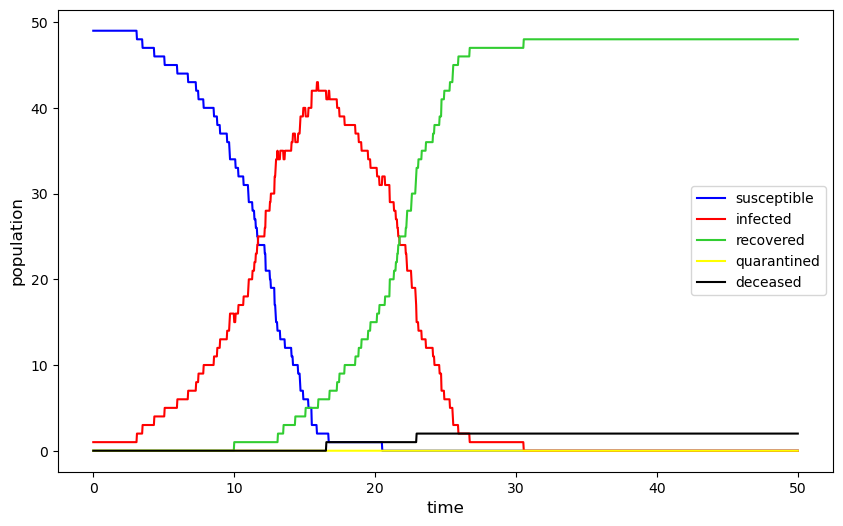

In [29]:
# Simulation parameters
nagents = 50
tmax = 50
social_distancing = False
quarantining = False
fatal = True

# Run model and plot populations    
abm_populations(covid)   

IntProgress(value=0, description='Running...', max=1500)

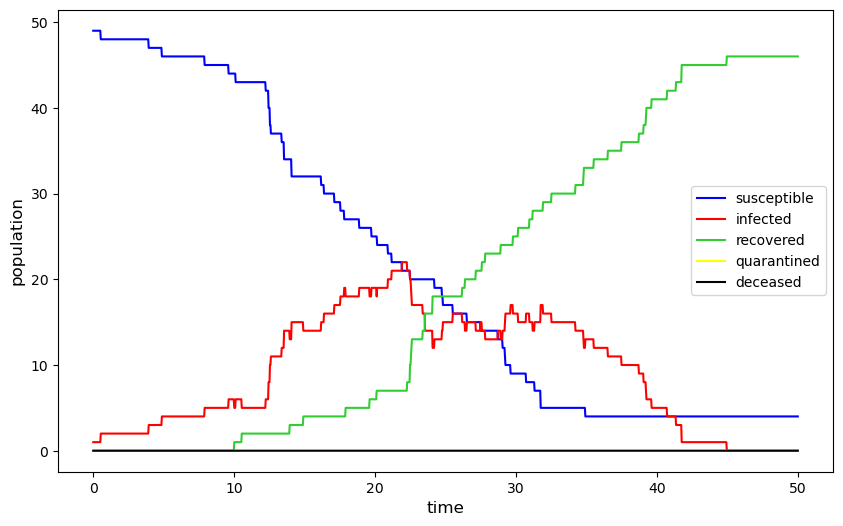

In [30]:
# Turn on social distancing
social_distancing = True
quarantining = False
fatal = True

# Run model and plot populations    
abm_populations(covid) 

IntProgress(value=0, description='Running...', max=1500)

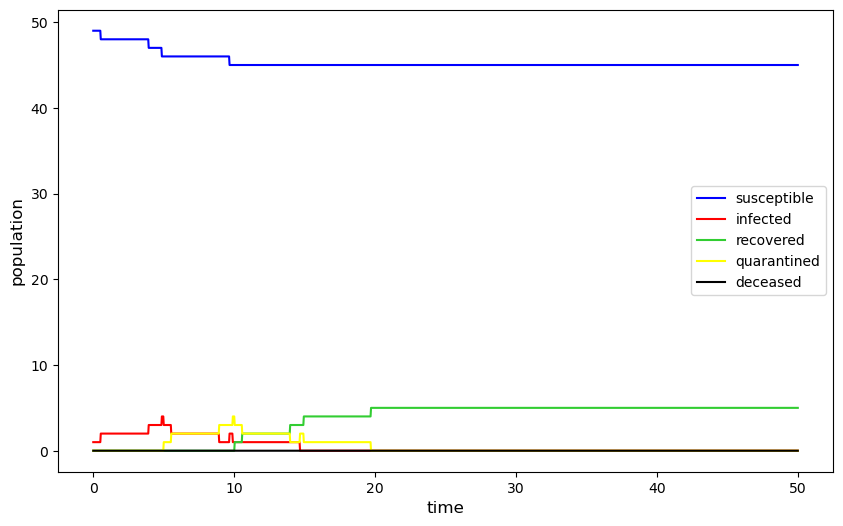

In [31]:
# Turn on social distancing
social_distancing = True
quarantining = True
fatal = True

# Run model and plot populations    
abm_populations(covid) 

To see the affects that quarantining has we can produce plots for the model with and without quarantining. What conclusions can you draw from these plots?

### Extending the model

The Covid model we have here is quite simplistic and makes the following assumptions about the population.

- Each agent has an equal chance of being infected if in close proximity to an infected agent.
- Each agent has an equal change of dying from the infection.
- All agents are obedient and will try to avoid other agents when social distancing is turned on.
- All agents will quarantine themselves if they know they are infected.
- Agents are evenly spread and do not cluster around certain areas (e.g., shops, schools etc.).

We could extend our model to take in these additional consideration into account. This is what makes mathematical modelling so useful.

---
## Useful Links

If you would like to further explore Python and fractals you may find the following links useful:

- [Anaconda](https://www.anaconda.com/products/distribution) - a suite of software tools that includes Jupyter Notebook and Python. Download and install on your computer to write and run Jupyter notebooks
- [Google Colab](https://colab.research.google.com/) - run Jupyter notebooks in the cloud using Google Colab (you will need to have a Google account to do this)
- [3Blue1Brown: Simulating an epidemic](https://www.youtube.com/watch?v=gxAaO2rsdIs) - a video by YouTube creator Grant Sanderson explaining the use of an agent based model to simulate an epidemic.
- [Agent based modelling](https://en.wikipedia.org/wiki/Agent-based_model)
- [Boids model](https://en.wikipedia.org/wiki/Boids)

&copy; Dr Jon Shiach 2022